In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['font.family'] = "sans-serif"
matplotlib.rcParams['font.family'] = "Arial"
import numpy as np
import matplotlib.pyplot as plt
from facilities import store_object, retrieve_object
from dPCA import dPCA
import pdb
import os



Bad key "legend.title_fontsize" on line 22 in
/Users/michael/.matplotlib/stylelib/notebook.mplstyle.
You probably need to get an updated matplotlibrc file from
http://github.com/matplotlib/matplotlib/blob/master/matplotlibrc.template
or from the matplotlib source distribution


## define paths -- IMPORTANT: update `dirpath` with you path/to/multi-area-cleaned

In [2]:
dirpath = '/Users/michael/Documents/GitHub/multi-area-cleaned/'
loadpath_data = dirpath + 'sims/revision/exemplar_new/scratch_data/'
savepath_figs = dirpath + 'sims/revision/exemplar_new/figs/'
savepath = dirpath + 'sims/revision/exemplar_new/scratch_data/'
modelpath = dirpath + 'examples/models/cb_analyze_fixed-cb.py'

if not os.path.exists(savepath_figs):
    os.makedirs(savepath_figs)

## Only run first time to generate data (can skip to output stage)

In [3]:
from pycog.trialRNN import PSTH

rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=7.pkl'

vin = 0.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.1**2 #0.05
psth = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6)
filename = filename_pkl[:-4] # to remove the .pkl

psth.set_align(align='cb')
psth.sort = ['dirs', 'scols']
psth.gen_psth()

# clear output
from IPython.display import clear_output
clear_output()

## saving psth related data

In [4]:
store_object(psth.psths, 'psths_dir_scol.p', savepath)
store_object(psth.rnn, 'rnn.p', savepath)
store_object(psth.trials, 'trials_dir_scol.p', savepath)
store_object(psth.rts, 'rts_dir_scol.p', savepath)
sorted_trials = psth.sort_trials()
store_object(sorted_trials, 'sorted_trials_dir_scol.p', savepath)

In [5]:
psth.sort = ['lrs', 'cohs']
psth.gen_psth()
store_object(psth.psths, 'psths_lrs_coh.p', savepath)

In [6]:
psth.sort = ['dirs', 'cohs']
psth.gen_psth()
store_object(psth.psths, 'psths_dirs_coh.p', savepath)

## generate tdr (can skip -- data is already saved)

In [7]:
idx1 = np.hstack((np.arange(80), np.arange(240, 260)))
idx2 = np.hstack((np.arange(80, 160), np.arange(260, 280)))
idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))
a,b,c,d = psth.tdr(idx1, idx2, idx3)
store_object(a, 'betas.p', savepath)
store_object(b, 'max_indices_l1.p', savepath)



## Start here: output stage
Figure 8b

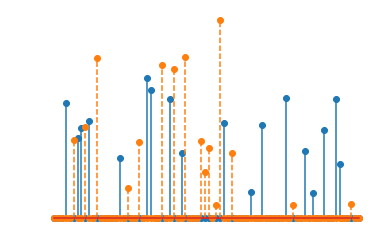

In [3]:
rnn = retrieve_object('rnn.p', loadpath_data)
idx3_exc = np.arange(160, 240)
Wout = rnn.Wout
Wout_reshaped = Wout[:, idx3_exc]
plt.stem(Wout_reshaped[0, :])
plt.stem(Wout_reshaped[1, :], linefmt='C1--', markerfmt='C1o')
plt.axis('off')
plt.savefig(savepath_figs + '/output_weights.pdf')

In [4]:
from matplotlib.colors import colorConverter
import matplotlib as mpl

def gradient(cmin, cmax):                                                                                                                                                                
    if isinstance(cmin, str):
        cmin = colorConverter.to_rgb(cmin)
    if isinstance(cmax, str):
        cmax = colorConverter.to_rgb(cmax)

    cdict = { 
        'red':   [(0, 0,       cmin[0]),
                  (1, cmax[0], 1)],
        'green': [(0, 0,       cmin[1]),
                  (1, cmax[1], 1)],
        'blue':  [(0, 0,       cmin[2]),
                  (1, cmax[2], 1)] 
        }   
    return mpl.colors.LinearSegmentedColormap('cmap', cdict, N=1000)

white = 'w'
blue  = '#2171b5' #plt.colors('strongblue')
red   = '#cb181d' #plt.colors('strongred')
# blue = 'b'
# red = 'r'

cmap_exc = gradient(white, blue)
cmap_inh_r = gradient(red, white)

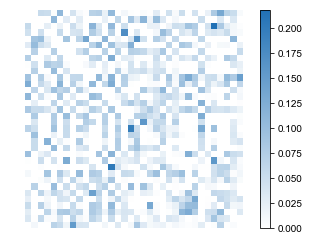

In [5]:
# Figure 8c

idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))
Wout_reshaped1 = Wout[:, idx3]
id1_wout = Wout_reshaped1[0, :] > 0.001 
id2_wout = Wout_reshaped1[1, :] > 0.001
id3_wout = id1_wout + id2_wout
id3_wout_c = np.invert(id3_wout)
Wrec = rnn.Wrec
W33 = Wrec[np.ix_(idx3, idx3)]

W33_out = W33[np.ix_(id3_wout, id3_wout)]
plt.imshow(W33_out, cmap=cmap_exc)
plt.colorbar()
plt.axis('off')
plt.savefig(savepath_figs + '/output_unsorted.pdf')

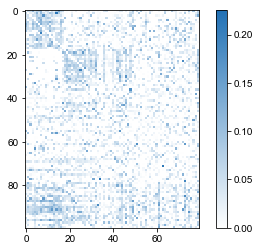

In [6]:
# Fig S13

A = W33[np.ix_(id1_wout, id1_wout)]
B = W33[np.ix_(id1_wout, id2_wout)]
C = W33[np.ix_(id1_wout, id3_wout_c)]
D = W33[np.ix_(id2_wout, id1_wout)]
E = W33[np.ix_(id2_wout, id2_wout)]
F = W33[np.ix_(id2_wout, id3_wout_c)]
G = W33[np.ix_(id3_wout_c, id1_wout)]
H = W33[np.ix_(id3_wout_c, id2_wout)]
I = W33[np.ix_(id3_wout_c, id3_wout_c)]
M = np.concatenate((A, B, C), axis=1)
N = np.concatenate((D, E, F), axis=1)
O = np.concatenate((G, H, I), axis=1)
Q = np.concatenate((M, N, O), axis=0)
plt.imshow(Q[:, :80], cmap=cmap_exc)
plt.colorbar()
plt.savefig(savepath_figs + '/wrec_exc.pdf')


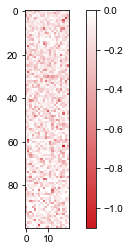

In [7]:
# Figure S13

plt.imshow(Q[:, 80:], cmap=cmap_inh_r)
plt.colorbar()
plt.savefig(savepath_figs + '/wrec_inh.pdf')


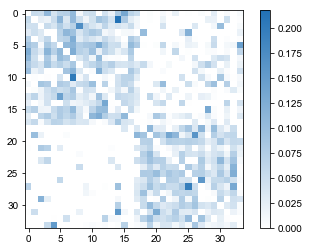

In [8]:
plt.imshow(Q[:np.sum(id3_wout), :np.sum(id3_wout)], cmap=cmap_exc)
plt.colorbar()
plt.savefig(savepath_figs + '/output_sorted.pdf')



## compute averages

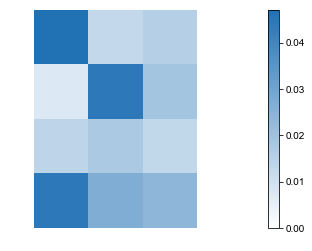

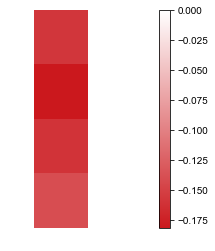

In [9]:
# Figure 8e
#(to, from)

idx1 = np.arange(np.sum(id1_wout))
idx2 = np.arange(np.sum(id1_wout), np.sum(id3_wout))
idx3 = np.arange(np.sum(id3_wout), 80)
idx4 = np.arange(80, 100)
avgs = np.zeros((4, 4))
avgs[0, 0] = np.mean(Q[np.ix_(idx1,idx1)])
avgs[0, 1] = np.mean(Q[np.ix_(idx1,idx2)])
avgs[1, 1] = np.mean(Q[np.ix_(idx2,idx2)])
avgs[1, 0] = np.mean(Q[np.ix_(idx2,idx1)])
avgs[2, 2] = np.mean(Q[np.ix_(idx3,idx3)])
avgs[2, 0] = np.mean(Q[np.ix_(idx3,idx1)])
avgs[2, 1] = np.mean(Q[np.ix_(idx3,idx2)])
avgs[0, 2] = np.mean(Q[np.ix_(idx1,idx3)])
avgs[1, 2] = np.mean(Q[np.ix_(idx2,idx3)])
avgs[0, 3] = np.mean(Q[np.ix_(idx1,idx4)])
avgs[1, 3] = np.mean(Q[np.ix_(idx2,idx4)])
avgs[2, 3] = np.mean(Q[np.ix_(idx3,idx4)])
avgs[3, 3] = np.mean(Q[np.ix_(idx4,idx4)])


avgs[3, 0] = np.mean(Q[np.ix_(idx4,idx1)])
avgs[3, 1] = np.mean(Q[np.ix_(idx4,idx2)])
avgs[3, 2] = np.mean(Q[np.ix_(idx4,idx3)])

concat = np.zeros((4, 1))

# cbar = mpl.colorbar.ColorbarBase(cmap=cmap_exc, norm=norm_exc, orientation='vertical')
plt.imshow(np.concatenate((avgs[:, :3], concat), axis = 1), interpolation='nearest', cmap=cmap_exc)
plt.axis('off')
plt.colorbar()
plt.savefig(savepath_figs + '/output_exc_avg.pdf')
plt.figure()
plt.imshow(np.concatenate((avgs[:, 3:], concat), axis = 1), interpolation='nearest', cmap=cmap_inh_r)
plt.axis('off')
plt.colorbar()
plt.savefig(savepath_figs + '/output_inh_avg.pdf')


## output plot

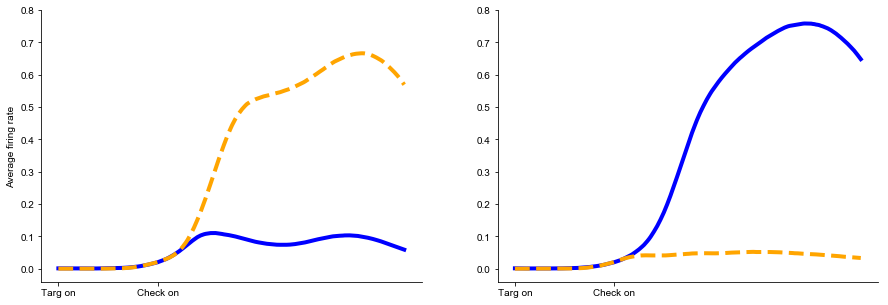

In [10]:
# psths shoudl be organize dir_scol
psths = retrieve_object('psths_dir_scol.p', loadpath_data)
rnn = retrieve_object('rnn.p', loadpath_data)

psth0 = psths[0]['psth']
psth1 = psths[1]['psth']
psth2 = psths[2]['psth']
psth3 = psths[3]['psth']
idx3 = np.hstack((np.arange(160, 240)))

Wout = rnn.Wout
Wout_reshaped = Wout[:, idx3]
id1_wout = Wout_reshaped[0, :] > 0.001 
id2_wout = Wout_reshaped[1, :] > 0.001

idx_left = id1_wout
idx_right = id2_wout
output_psths_left = (psth0[160:240, :] + psth1 [160:240, :])/2
output_psths_right = (psth2[160:240, :] + psth3 [160:240, :])/2

left_1 = output_psths_left[idx_left]
right_1 = output_psths_left[idx_right]

left_2 = output_psths_right[idx_left]
right_2 = output_psths_right[idx_right]

# plotting
fig = plt.figure(figsize=(15,5))
ax = plt.subplot(121)
ax.plot(np.mean(right_1, axis=0)[90:300], 'b', linewidth = 4)
ax.plot(np.mean(left_1, axis=0)[90:300], '--', color="orange", linewidth = 4)
plt.xticks([0, 60], ['Targ on', 'Check on'])
plt.ylim(-0.04, 0.8)
plt.ylabel('Average firing rate')

# Hide the right and top spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

# Only show ticks on the left and bottom spines
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

ax = plt.subplot(122)
ax.plot(np.mean(right_2, axis=0)[90:300], 'b', linewidth = 4)
ax.plot(np.mean(left_2, axis=0)[90:300], '--', color="orange", linewidth = 4)
plt.xticks([0, 60], ['Targ on', 'Check on'])
bottom, top = plt.ylim()
# Hide the right and top spines
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.ylim(-0.04, 0.8)

# plt.yticks([0, 0.04, 0.08, 0.12])

# Only show ticks on the left and bottom spines
ax.yaxis.set_ticks_position('left')
ax.xaxis.set_ticks_position('bottom')

plt.savefig(savepath_figs + '/average_rates_output.pdf')

## perturbation experiment 
Figure 8g

In [12]:
import sys
import subprocess
import numpy as np
import os
import cPickle as pkl
import matplotlib.pyplot as plt
import pdb
from pycog.trialRNN import PSTH

rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=7.pkl'


# run trials to get PSTHs
vin = 0.10**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05**2
nt = 200

psth = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=nt, seed=1, threshold=0.6)
filename = filename_pkl[:-4] # to remove the .pkl

psth.sort = ['dirs', 'scols']
psth.set_align(align='cb')

idx1 = np.hstack((np.arange(80), np.arange(240, 260)))
idx2 = np.hstack((np.arange(80, 160), np.arange(260, 280)))
idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))
Wout = psth.rnn.Wout
Wout_reshaped = Wout[:, idx3]
id1_wout = Wout_reshaped[0, :] > 0.001 
id2_wout = Wout_reshaped[1, :] > 0.001
idx_left = id1_wout
idx_right = id2_wout

Wrec = np.copy(psth.rnn.Wrec)
toModify_initial = np.copy(Wrec[160:260, :][:, 280:300])
rng = np.random.RandomState(1000)

count_right_store = np.zeros((15,))
thresh = [0.1]
for ii in range(len(thresh)):
    toModify = np.copy(toModify_initial)
    toModify[idx_right, :] += 1 *(rng.uniform(size=(sum(idx_right), 20)) < thresh[ii]) * toModify[idx_right, :]
    Wrec[160:260, :][:, 280:300] = toModify

    psth_right = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=nt, seed=1, threshold=0.6, Wrec=Wrec)
    filename = filename_pkl[:-4] # to remove the .pkl

Wrec = np.copy(psth.rnn.Wrec)
rng = np.random.RandomState(1000)    
for ii in range(len(thresh)):
    toModify = np.copy(toModify_initial)
    toModify[idx_left, :] += 1 *(rng.uniform(size=(sum(idx_left), 20)) < thresh[ii]) * toModify[idx_left, :]
    Wrec[160:260, :][:, 280:300] = toModify

    psth_left = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=nt, seed=1, threshold=0.6, Wrec=Wrec)
    filename = filename_pkl[:-4] # to remove the .pkl

# clear output
from IPython.display import clear_output
clear_output()

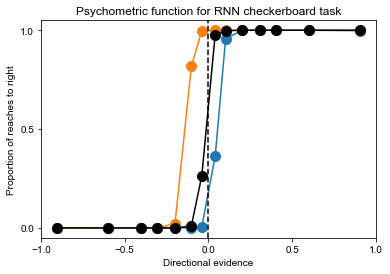

In [13]:
from __future__ import division

conds = psth.conds
conds_cohs = 2*(conds / 225) - 1
correct_choices = np.array([trial['info']['choice'] for trial in psth.trials])
ev_cohs = np.abs(conds_cohs) * correct_choices
u_conds             = np.unique(conds_cohs)
choose_left = np.zeros_like(u_conds).astype(float)
choose_right = np.zeros_like(u_conds).astype(float)
choose_normal = np.zeros_like(u_conds).astype(float)

for i,cond in enumerate(u_conds):

    m2 = np.where(np.abs(ev_cohs - cond) < 0.001)[0]
    choose_left[i] = np.sum(psth_left.choices[m2] == 1) 
    choose_right[i] = np.sum(psth_right.choices[m2] == 1)  
    choose_normal[i] = np.sum(psth.choices[m2] == 1)  # this is only getting reaches to the right

    choose_left[i] /= (len(m2)) 
    choose_right[i] /= (len(m2)) 
    choose_normal[i] /= (len(m2))   # this is only getting reaches to the right   
    
    
f   = plt.figure()
ax  = f.gca()

# want right to be in blue
ax.plot(u_conds, choose_right, marker='.', markersize=20)
ax.plot(u_conds, choose_left, marker='.', markersize=20)
ax.plot(u_conds, choose_normal, marker='.', markersize=20, color='black')


ax.axvline(0, linestyle='--', color = 'black')
ax.set_ylim((-0.05, 1.05))
ax.set_xlim((-1.0, 1.0))
ax.set_yticks((0, 0.5, 1))
ax.set_xticks((-1, -0.5, 0, 0.5, 1))
ax.set_xlabel('Directional evidence')
ax.set_ylabel('Proportion of reaches to right')
ax.set_title('Psychometric function for RNN checkerboard task')

plt.savefig(savepath_figs + '/perturb_psych.pdf')

## tSNE 3 area

Figure 2f. Note: To run this is requires `trials_dir_scol.p` (which is ~4.5Gb) to be in `loadpath_exemplar_data`. You can generate the data in the above cells (saving psth related data cells -- this takes ~10minutes), or download the file directly https://drive.google.com/file/d/1EifkvZMEHDJp885bf2qTpgfP5vc-leWO/view?usp=sharing. The following cell takes ~2 minutes to run.

In [24]:
from sklearn.manifold import TSNE

psths = retrieve_object('psths_dir_scol.p', loadpath_data)
rts = retrieve_object('rts_dir_scol.p', loadpath_data)
trials = retrieve_object('trials_dir_scol.p', loadpath_data)
sorted_trials = retrieve_object('sorted_trials_dir_scol.p', loadpath_data)
bounds = [-300, 100] 

time_mv = rts + [int(trial['info']['epochs']['check'][0]) for trial in trials]
time_mv = time_mv // psth.dt
time_mv = time_mv.astype(int)
rstarts = time_mv + bounds[0] // psth.dt
rends   = time_mv + bounds[1] // psth.dt

# sorted_trials = psth.sort_trials()
trials0     = trials[sorted_trials[0]['idxs']]
trials1     = trials[sorted_trials[1]['idxs']]
trials2     = trials[sorted_trials[2]['idxs']]
trials3     = trials[sorted_trials[3]['idxs']]

rates0 = np.array([np.mean(trial['r'][:, rstarts[idx]:rends[idx]], axis=1) for idx, trial in zip(sorted_trials[0]['idxs'], trials0)]).T
rates1 = np.array([np.mean(trial['r'][:, rstarts[idx]:rends[idx]], axis=1) for idx, trial in zip(sorted_trials[1]['idxs'], trials1)]).T
rates2 = np.array([np.mean(trial['r'][:, rstarts[idx]:rends[idx]], axis=1) for idx, trial in zip(sorted_trials[2]['idxs'], trials2)]).T
rates3 = np.array([np.mean(trial['r'][:, rstarts[idx]:rends[idx]], axis=1) for idx, trial in zip(sorted_trials[3]['idxs'], trials3)]).T

idx_nans0 = np.array([np.isnan(rate) for rate in rates0])
idx_keep0 = np.array([not np.all(bool_across_trials) for bool_across_trials in idx_nans0.T])
idx_nans1 = np.array([np.isnan(rate) for rate in rates1])
idx_keep1 = np.array([not np.all(bool_across_trials) for bool_across_trials in idx_nans1.T])
idx_nans2 = np.array([np.isnan(rate) for rate in rates2])
idx_keep2 = np.array([not np.all(bool_across_trials) for bool_across_trials in idx_nans2.T])
idx_nans3 = np.array([np.isnan(rate) for rate in rates3])
idx_keep3 = np.array([not np.all(bool_across_trials) for bool_across_trials in idx_nans3.T])

rates0  = rates0[:, idx_keep0]
rates1  = rates1[:, idx_keep1]
rates2  = rates2[:, idx_keep2]
rates3  = rates3[:, idx_keep3]

ind1 = rates0.shape[1]
ind2 = rates1.shape[1]
ind3 = rates2.shape[1]
ind4 = rates3.shape[1]

# perform tSNE
rates_store = np.concatenate((rates0, rates1, rates2, rates3), axis=1)
X1 = rates_store[idx1, :].T
X2 = rates_store[idx2, :].T
X3 = rates_store[idx3, :].T
X_embedded1 = TSNE(n_components=2).fit_transform(X1)
X_embedded2 = TSNE(n_components=2).fit_transform(X2)
X_embedded3 = TSNE(n_components=2).fit_transform(X3)

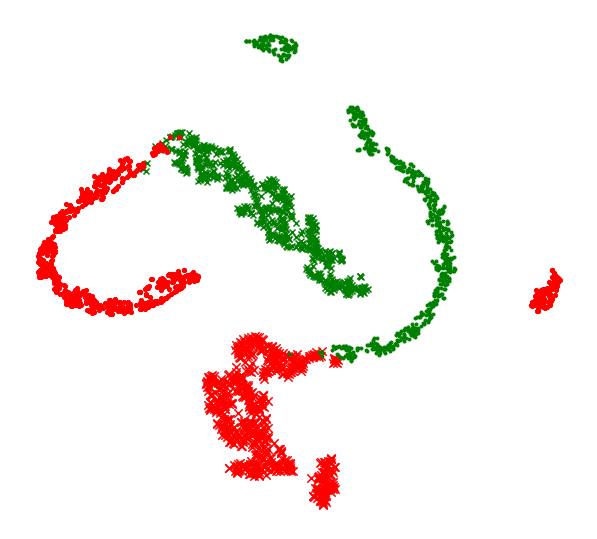

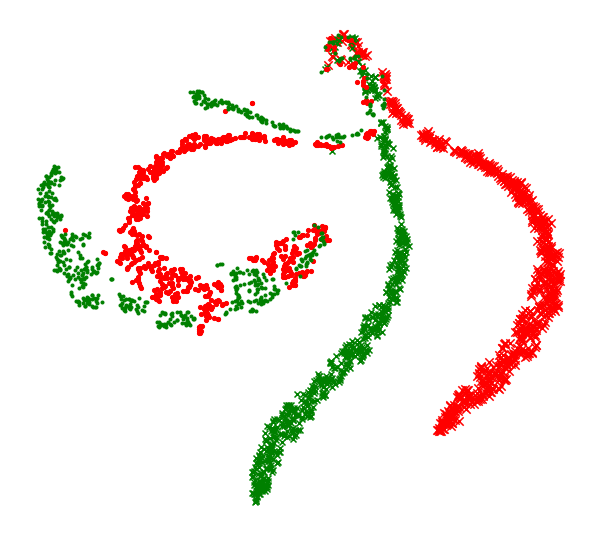

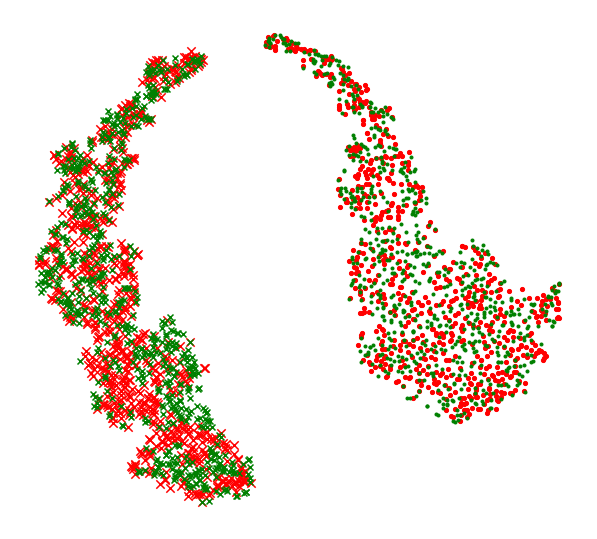

In [98]:
def plot_tsne(X_embedded):
    fig = plt.figure(figsize=(8, 8))
    ax = plt.axes(frameon=False)
    plt.setp(ax, xticks=(), yticks=())
    plt.subplots_adjust(left=0.0, bottom=0.0, right=1.0, top=0.9, wspace=0.0, hspace=0.0)

    plt.scatter(X_embedded[:ind1, 0], X_embedded[:ind1, 1], marker='x', c='r', s=70)
    plt.scatter(X_embedded[ind1:ind1+ind2, 0], X_embedded[ind1:ind1+ind2, 1], marker='x', c='g')
    plt.scatter(X_embedded[ind1+ind2:ind1+ind2+ind3, 0], X_embedded[ind1+ind2:ind1+ind2+ind3, 1], marker='.', c='r', s=70)
    plt.scatter(X_embedded[ind1+ind2+ind3:, 0], X_embedded[ind1+ind2+ind3:, 1], marker='.', c='g')

plot_tsne(X_embedded1)
plt.savefig(savepath_figs + '/tsne_a1.pdf')
plot_tsne(X_embedded2)
plt.savefig(savepath_figs + '/tsne_a2.pdf')
plot_tsne(X_embedded3)
plt.savefig(savepath_figs + '/tsne_a3.pdf')

## Principal component plots

[ pycog.rnn.RNN ] 16500 updates, best error = 0.20798652, spectral radius = 1.84214282
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.00964285714286


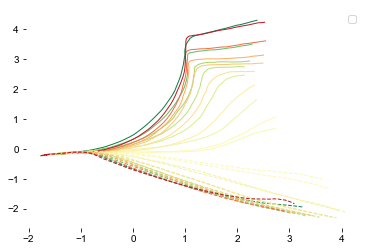

In [16]:
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=7.pkl'

vin = 0 # 0.1 ** 2 #.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.05 ** 2 #.05 ** 2 #0.1**2 #0.05
filename = filename_pkl[:-4]

idx1 = np.hstack((np.arange(80), np.arange(240, 260)))
idx2 = np.hstack((np.arange(80, 160), np.arange(260, 280)))
idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))
partition_pca = [idx1, idx2, idx3]
from pycog.trialRNN import Dynamics
dyn = Dynamics(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6, align='cb', partition_pca=partition_pca) 
dyn.dims = np.array([0,1])
dyn.plot_neural_traj2d_partition_pub(savepath=savepath_figs, filename=filename + '_PC12.pdf', windowStart=70, windowEnd=100, targ_on_label=False, go_cue_label=False)


[ pycog.rnn.RNN ] 16500 updates, best error = 0.20798652, spectral radius = 1.84214282
 Trial 560/560: left_right: -1, cond: 158
The proportion of NaN RTs is 0.0


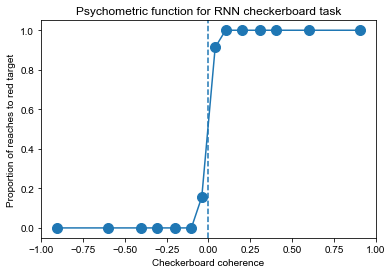

In [15]:
from pycog.trialRNN import Trial
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=7.pkl'
vin = 0.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.1**2 #0.05

trial = Trial(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=20, threshold=0.6)
filename = filename_pkl[:-4]  # to remove the .pkl
cohs, red_rates, _ = trial.psychometric(savepath=None, filename=filename + '_psychometric')



## choice probabilities

The first cell generates the choice probability for the single area (by setting `single_area = True`) or a 3 area by setting `single_area = False`. The data is already saved, so this cell can be skipped.

In [4]:
from pycog.trialRNN import PSTH
single_area = True

rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
coh_cps_store = np.zeros((300,8))
dir_cps_store = np.zeros((300, 8))

for i in range(8):
    if single_area:
        filename_pkl = '2020-04-10_cb_simple_1area_seed=' + str(i) + '.pkl'
        rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_1area/'
    else:
        filename_pkl = '2020-04-10_cb_simple_3areas_seed=' + str(i) + '.pkl'    


    vin = 0.10**2
    var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
    var_rec = 0.05**2

    psth = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6)

    psth.sort = ['scols']
    psth.set_align(align='mv')

    psth.gen_psth()
    coh_cps = psth.choice_prob(bounds=[-300,100])

    psth.sort = ['dirs']
    psth.set_align(align='mv')
    psth.gen_psth()
    dir_cps = psth.choice_prob(bounds=[-300,100])

    idx1 = np.hstack((np.arange(80), np.arange(240, 260)))
    idx2 = np.hstack((np.arange(80, 160), np.arange(260, 280)))
    idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))

    coh_cps_store[:, i] = coh_cps
    dir_cps_store[:, i] = dir_cps

prefix_single = ''
if single_area:
    prefix_single = '1area_'

np.save(savepath + prefix_single + 'coh_cps.npy', coh_cps_store)
np.save(savepath + prefix_single + 'dir_cps.npy', dir_cps_store)


[ pycog.rnn.RNN ] 1000 updates, best error = 0.24887928, spectral radius = 4.53050375
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0907142857143


/Users/michael/.virtualenvs/py2-tibi/lib/python2.7/site-packages/numpy/core/fromnumeric.py:2957: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/Users/michael/.virtualenvs/py2-tibi/lib/python2.7/site-packages/numpy/core/_methods.py:73: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


[ pycog.rnn.RNN ] 1000 updates, best error = 0.24994063, spectral radius = 4.20917368
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.095
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24822454, spectral radius = 4.32747984
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0796428571429
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24782060, spectral radius = 4.46393299
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0528571428571
[ pycog.rnn.RNN ] 1000 updates, best error = 0.25080392, spectral radius = 4.47698355
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0728571428571
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24698590, spectral radius = 4.78943729
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0821428571429
[ pycog.rnn.RNN ] 1000 updates, best error = 0.25524873, spectral radius = 3.30147982
 Trial 2800/2800: left_right: -1, cond: 11
The proport

## plotting cps

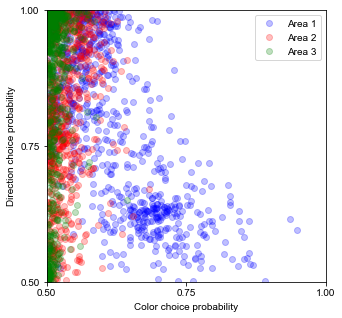

In [25]:
coh_cps = np.load(loadpath_data + 'coh_cps.npy')
dir_cps = np.load(loadpath_data + 'dir_cps.npy')
idx1 = np.hstack((np.arange(80), np.arange(240, 260)))
idx2 = np.hstack((np.arange(80, 160), np.arange(260, 280)))
idx3 = np.hstack((np.arange(160, 240), np.arange(280, 300)))

f = plt.figure(figsize=(5,5))
ax = f.gca()
ax.scatter(coh_cps[idx1, :].reshape(-1), dir_cps[idx1, :].reshape(-1), color='b', alpha=0.25, label='Area 1')
ax.scatter(coh_cps[idx2, :].reshape(-1), dir_cps[idx2, :].reshape(-1), color='r', alpha=0.25, label='Area 2')
ax.scatter(coh_cps[idx3, :].reshape(-1), dir_cps[idx3, :].reshape(-1), color='g', alpha=0.25, label='Area 3')
ax.set_xlabel('Color choice probability')
ax.set_ylabel('Direction choice probability')
ax.set_xticks([0.5, 0.75, 1])
ax.set_yticks([0.5, 0.75, 1])
ax.set_xlim(0.5, 1)
ax.set_ylim(0.5, 1)
plt.legend()

plt.savefig(savepath_figs + 'cp_3area.pdf')

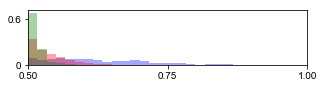

In [17]:
plt.figure(figsize=(5,1))
plt.hist(coh_cps[idx1,:].reshape(-1), 30, color='b', range = (0.5, 1), alpha=0.35)
plt.hist(coh_cps[idx2,:].reshape(-1), 30, color='r', range = (0.5, 1), alpha=0.35)
plt.hist(coh_cps[idx3,:].reshape(-1), 30, color='g', range = (0.5, 1), alpha=0.35)
plt.xlim(0.5, 1)
plt.xticks([0.5, 0.75, 1])
plt.yticks([0, 480], [0, 0.6])

plt.savefig(savepath_figs + 'cp_hist_col.pdf')

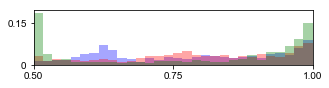

In [18]:
plt.figure(figsize=(5,1))
plt.hist(dir_cps[idx1,:].reshape(-1), 30, color='b', range = (0.5, 1), alpha=0.35)
plt.hist(dir_cps[idx2,:].reshape(-1), 30, color='r', range = (0.5, 1), alpha=0.35)
plt.hist(dir_cps[idx3,:].reshape(-1), 30, color='g', range = (0.5, 1), alpha=0.35)
plt.xlim(0.5, 1)
plt.xticks([0.5, 0.75, 1])
plt.yticks([0, 120], [0, 0.15])


plt.savefig(savepath_figs + 'cp_hist_dir.pdf')

## single RNN choice probabilities 
Figure S2f

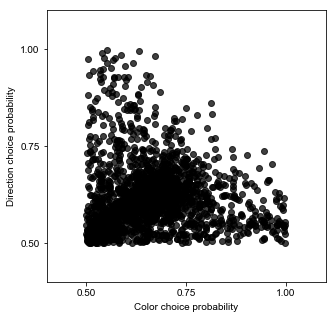

In [19]:
coh_cps = np.load(loadpath_data + '1area_coh_cps.npy')
dir_cps = np.load(loadpath_data + '1area_dir_cps.npy')

plt.figure(figsize=(5,5))
plt.scatter(coh_cps, dir_cps, color = 'black', alpha = 0.75)
plt.xlim(0.4, 1.1)
plt.ylim(0.4, 1.1)
plt.xticks([0.5, 0.75, 1])
plt.yticks([0.5, 0.75, 1])
plt.xlabel('Color choice probability')
plt.ylabel('Direction choice probability')

plt.savefig(savepath_figs + 'cp_1area.pdf')

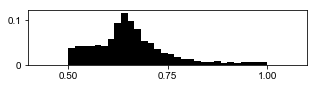

In [20]:
plt.figure(figsize=(5,1))
plt.hist(coh_cps.reshape(-1), 30, color='black', range = (0.5, 1))
plt.xlim(0.4, 1.1)
plt.yticks([0, 240], [0, 0.1])
plt.xticks([0.5, 0.75, 1])
plt.savefig(savepath_figs + 'cp_1area_col.pdf')

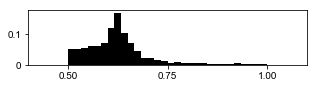

In [21]:
plt.figure(figsize=(5,1))
plt.hist(dir_cps.reshape(-1), 30, color='black', range = (0.5, 1))
plt.xlim(0.4, 1.1)
plt.xticks([0.5, 0.75, 1])
plt.yticks([0, 240], [0, 0.1])
plt.savefig(savepath_figs + 'cp_1area_dir.pdf')

## generate reaction time plots for S1 and S2 (top). This cell does not need to be rerun.

[ pycog.rnn.RNN ] 1000 updates, best error = 0.24887928, spectral radius = 4.53050375
 Trial 5600/5600: left_right: 1, cond: 45
The proportion of NaN RTs is 0.0894642857143
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24994063, spectral radius = 4.20917368
 Trial 5600/5600: left_right: 1, cond: 45
The proportion of NaN RTs is 0.0894642857143
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24822454, spectral radius = 4.32747984
 Trial 5600/5600: left_right: 1, cond: 45
The proportion of NaN RTs is 0.0753571428571
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24782060, spectral radius = 4.46393299
 Trial 5600/5600: left_right: 1, cond: 45
The proportion of NaN RTs is 0.0533928571429
[ pycog.rnn.RNN ] 1000 updates, best error = 0.25080392, spectral radius = 4.47698355
 Trial 5600/5600: left_right: 1, cond: 45
The proportion of NaN RTs is 0.0723214285714
[ pycog.rnn.RNN ] 1000 updates, best error = 0.24698590, spectral radius = 4.78943729
 Trial 5600/5600: left_right: 1, cond: 45
The pro

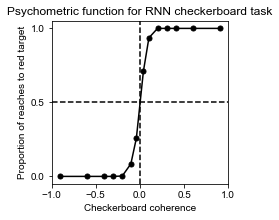

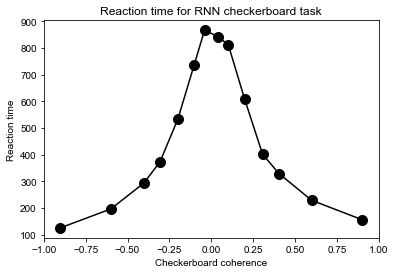

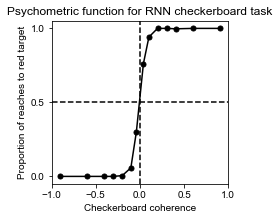

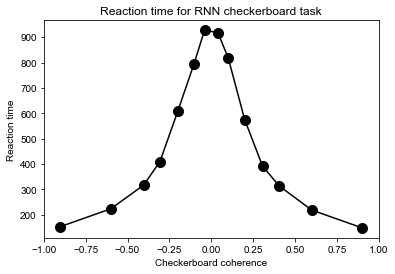

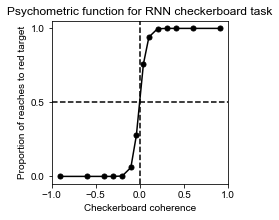

...

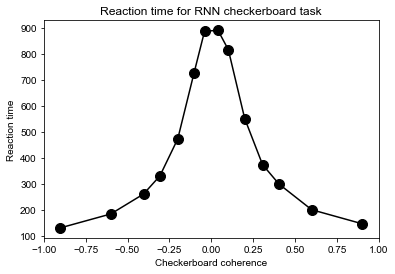

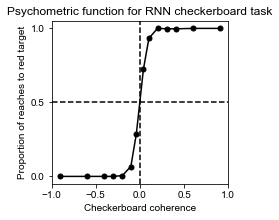

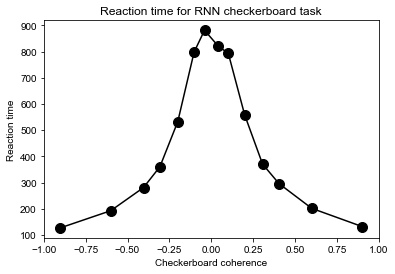

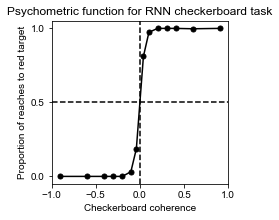

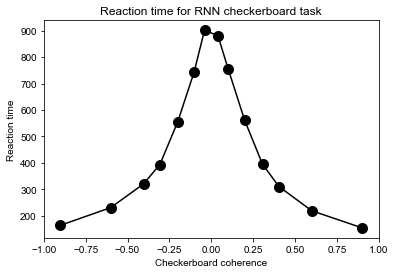

In [112]:
single_area = True

cohs_store = np.zeros((14, 8))
red_rates_store = np.zeros((14, 8))
rts_cond_store = np.zeros((14, 8))
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'

for i in range(8):
    if single_area:
        filename_pkl = '2020-04-10_cb_simple_1area_seed=' + str(i) + '.pkl'
        rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_1area/'
    else:
        filename_pkl = '2020-04-10_cb_simple_3areas_seed=' + str(i) + '.pkl'


    # run trials
    vin = 0.10**2
    var_in = np.array(((0, 0, 0, 0), (0, 0, 0, 0), (0, 0, vin, 0), (0, 0, 0, vin)))  # 0.20**2
    var_rec = 0.05**2

    trial = Trial(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=200, threshold=0.6)

    filename = filename_pkl[:-4]  # to remove the .pkl
    # generate behavioral plots
    cohs, red_rates, _ = trial.psychometric(savepath=None, filename=filename + '_psychometric')
    rts_cond = trial.reaction_time(savepath=None, filename=filename + '_rt')
    cohs_store[:, i] = cohs
    red_rates_store[:, i] = red_rates
    rts_cond_store[:, i] = rts_cond

data_savepath = dirpath + "sims/revision/exemplar_new/scratch_data/"
prefix_single = ''
if single_area:
    prefix_single = '1area_'
    
np.save(data_savepath + prefix_single + 'cohs_store.npy', cohs_store)
np.save(data_savepath + prefix_single + 'red_rates_store.npy', red_rates_store)
np.save(data_savepath + prefix_single + 'rts_cond_store.npy', rts_cond_store)

## psths for 3-area RNN

[ pycog.rnn.RNN ] 16500 updates, best error = 0.20798652, spectral radius = 1.84214282
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.00535714285714
Plotting PSTH for neuron 0
Plotting PSTH for neuron 1
Plotting PSTH for neuron 2
Plotting PSTH for neuron 3
Plotting PSTH for neuron 4
Plotting PSTH for neuron 5
Plotting PSTH for neuron 6
Plotting PSTH for neuron 7
Plotting PSTH for neuron 8
Plotting PSTH for neuron 9
Plotting PSTH for neuron 10
Plotting PSTH for neuron 11
Plotting PSTH for neuron 12
Plotting PSTH for neuron 13
Plotting PSTH for neuron 14
Plotting PSTH for neuron 15
Plotting PSTH for neuron 16
Plotting PSTH for neuron 17
Plotting PSTH for neuron 18
Plotting PSTH for neuron 19
Plotting PSTH for neuron 20
Plotting PSTH for neuron 21
Plotting PSTH for neuron 22
Plotting PSTH for neuron 23
Plotting PSTH for neuron 24
Plotting PSTH for neuron 25
Plotting PSTH for neuron 26
Plotting PSTH for neuron 27
Plotting PSTH for neuron 28
Plotting PSTH for neur

Plotting PSTH for neuron 282
Plotting PSTH for neuron 283
Plotting PSTH for neuron 284
Plotting PSTH for neuron 285
Plotting PSTH for neuron 286
Plotting PSTH for neuron 287
Plotting PSTH for neuron 288
Plotting PSTH for neuron 289
Plotting PSTH for neuron 290
Plotting PSTH for neuron 291
Plotting PSTH for neuron 292
Plotting PSTH for neuron 293
Plotting PSTH for neuron 294
Plotting PSTH for neuron 295
Plotting PSTH for neuron 296
Plotting PSTH for neuron 297
Plotting PSTH for neuron 298
Plotting PSTH for neuron 299


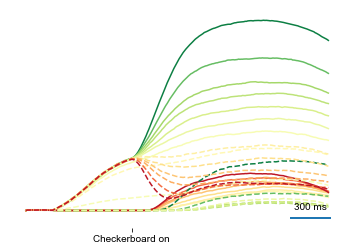

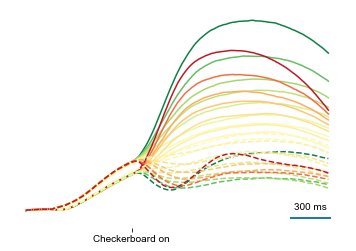

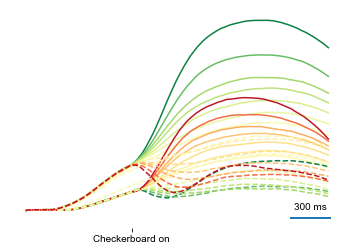

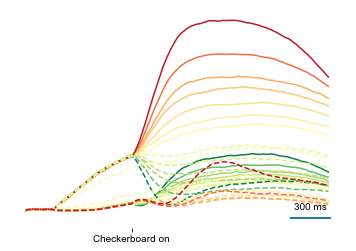

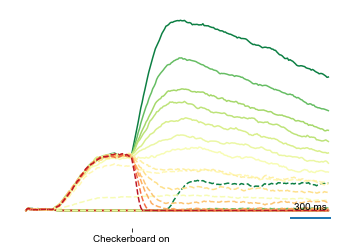

...

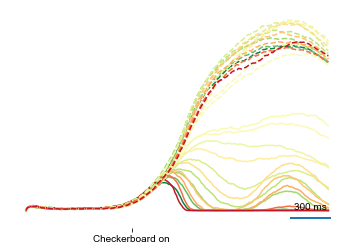

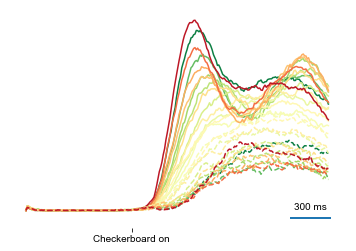

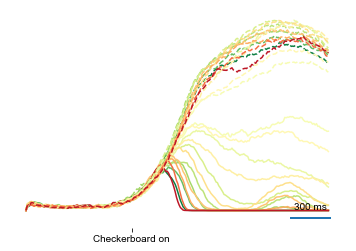

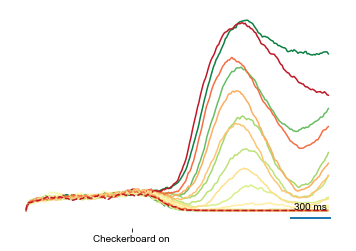

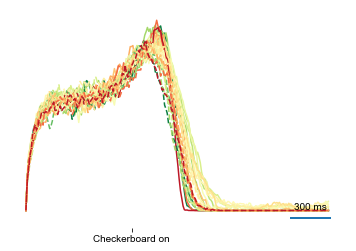

In [28]:
from pycog.trialRNN import PSTH


savepath_psths_figs = dirpath + 'sims/revision/exemplar_new/figs/psths/'
if not os.path.exists(savepath_psths_figs):
    os.makedirs(savepath_psths_figs)

rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=' + '7' + '.pkl'
vin = 0.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.1**2 #0.05
psth = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6)
filename = filename_pkl[:-4] # to remove the .pkl

psth.sort=['dirs', 'cohs']
psth.set_align(align='cb')
psth.gen_psth()

psth.plot_psth_pub(savepath=savepath_psths_figs, filename=filename)


## pc plot of all units

[ pycog.rnn.RNN ] 16500 updates, best error = 0.20798652, spectral radius = 1.84214282
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.00535714285714


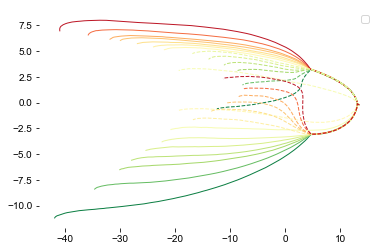

In [4]:
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_3areas/'
filename_pkl = '2020-04-10_cb_simple_3areas_seed=7.pkl'

vin = 0.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.1**2 #0.05
filename = filename_pkl[:-4]

idx1 = np.arange(300)
partition_pca = [idx1]
from pycog.trial_chandr import Dynamics
dyn = Dynamics(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6, align='cb', partition_pca=partition_pca) 
dyn.dims = np.array([0,1])
dyn.plot_neural_traj2d_partition_pub(savepath=savepath_figs, filename=filename + '_PC12.pdf', windowStart=20, windowEnd=100)


## pc plot of single area RNN

/Users/michael/Documents/GitHub/multi-area-cleaned/pycog/trial_chandr.py:15: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/usr/local/Cellar/python@2/2.7.17_1/Frameworks/Python.framework/Versions/2.7/lib/python2.7/runpy.py", line 174, in _run_module_as_main
    "__main__", fname, loader, pkg_name)
  File "/usr/local/Cellar/python@2/2.7.17_1/Frameworks/Python.framework/Versions/2.7/lib/python2.7/runpy.py", line 72, in _run_code
    exec code in run_globals
  File "/Users/michael/.virtualenvs/multi-area-cleaned/lib/python2.7/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/michael/.virtualenvs/multi-area-cleaned/lib/python2.7/site-packages/traitlets/

[ pycog.rnn.RNN ] 1000 updates, best error = 0.24379663, spectral radius = 4.55382156
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0557142857143


/Users/michael/Documents/GitHub/multi-area-cleaned/pycog/trial_chandr.py:1156: RuntimeWarning: Mean of empty slice
  psth = np.nanmean(p_mtx, axis=0)


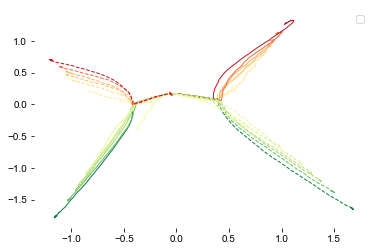

In [4]:
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_1area/'
filename_pkl = '2020-04-10_cb_simple_1area_seed=7.pkl'

vin = 0.1 ** 2 #0.2**2
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))#0.20**2
var_rec = 0.05 ** 2 #0.1**2 #0.05
filename = filename_pkl[:-4]

idx1 = np.arange(300)
partition_pca = [idx1]
from pycog.trial_chandr import Dynamics
dyn = Dynamics(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6, align='cb', partition_pca=partition_pca) 
dyn.dims = np.array([0,1])
dyn.plot_neural_traj2d_partition_pub(savepath=savepath_figs, filename=filename + '_PC12.pdf', windowStart=20, windowEnd=100)


In [5]:
def pca(data):  # the dimensions are rows, the observations are columns                                                                                                                  
    means           = np.mean(data, axis=1)
    data_centered   = (data.T - means).T
    evecs, evals, _ = np.linalg.svd(np.cov(data_centered))
    scores          = np.dot(evecs.T, data_centered)
    return evecs, evals, scores, means

# TODO Save the psths
psths = dyn.psths

num_cond1 = 2
num_cond2 = len(psths) // num_cond1
idx1 = np.arange(300)


X1 = np.zeros((len(idx1), 210, num_cond1, num_cond2))


for i in range(num_cond1):
    for j in range(num_cond2):
        X1[:, :, i, j] = psths[i * num_cond1 + j]['psth'][idx1, 90:300]


conc_psths_1 = X1.reshape(len(idx1), -1)


_, evals1, _, _ = pca(conc_psths_1)


print('Top 2 Components')
print('Single Area Variance: ' + str(np.sum(evals1[:2])/np.sum(evals1) * 100))


Top 2 Components
Single Area Variance: 83.61977174494865


In [10]:
np.sum(evals1[:2])/np.sum(evals1) * 100

83.61977174494865

## psths for single area RNN

[ pycog.rnn.RNN ] 1000 updates, best error = 0.24379663, spectral radius = 4.55382156
 Trial 2800/2800: left_right: -1, cond: 11
The proportion of NaN RTs is 0.0557142857143
Plotting PSTH for neuron 0
Plotting PSTH for neuron 1
Plotting PSTH for neuron 2
Plotting PSTH for neuron 3
Plotting PSTH for neuron 4
Plotting PSTH for neuron 5
Plotting PSTH for neuron 6
Plotting PSTH for neuron 7
Plotting PSTH for neuron 8
Plotting PSTH for neuron 9
Plotting PSTH for neuron 10
Plotting PSTH for neuron 11
Plotting PSTH for neuron 12
Plotting PSTH for neuron 13
Plotting PSTH for neuron 14
Plotting PSTH for neuron 15
Plotting PSTH for neuron 16
Plotting PSTH for neuron 17
Plotting PSTH for neuron 18
Plotting PSTH for neuron 19
Plotting PSTH for neuron 20
Plotting PSTH for neuron 21


/Users/michael/.virtualenvs/py2-multi/lib/python2.7/site-packages/matplotlib/pyplot.py:522: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


Plotting PSTH for neuron 22
Plotting PSTH for neuron 23
Plotting PSTH for neuron 24
Plotting PSTH for neuron 25
Plotting PSTH for neuron 26
Plotting PSTH for neuron 27
Plotting PSTH for neuron 28
Plotting PSTH for neuron 29
Plotting PSTH for neuron 30
Plotting PSTH for neuron 31
Plotting PSTH for neuron 32
Plotting PSTH for neuron 33
Plotting PSTH for neuron 34
Plotting PSTH for neuron 35
Plotting PSTH for neuron 36
Plotting PSTH for neuron 37
Plotting PSTH for neuron 38
Plotting PSTH for neuron 39
Plotting PSTH for neuron 40
Plotting PSTH for neuron 41
Plotting PSTH for neuron 42
Plotting PSTH for neuron 43
Plotting PSTH for neuron 44
Plotting PSTH for neuron 45
Plotting PSTH for neuron 46
Plotting PSTH for neuron 47
Plotting PSTH for neuron 48
Plotting PSTH for neuron 49
Plotting PSTH for neuron 50
Plotting PSTH for neuron 51
Plotting PSTH for neuron 52
Plotting PSTH for neuron 53
Plotting PSTH for neuron 54
Plotting PSTH for neuron 55
Plotting PSTH for neuron 56
Plotting PSTH for ne

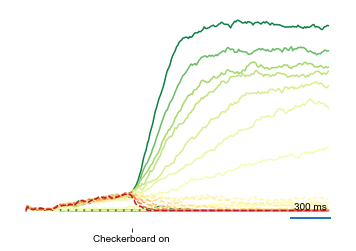

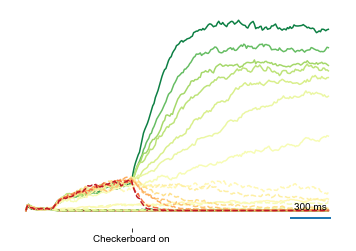

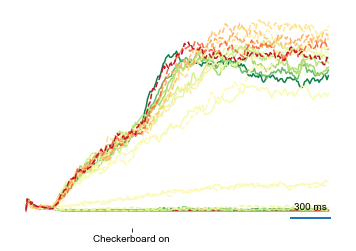

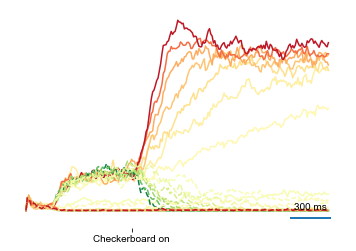

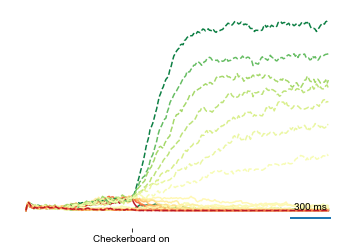

...

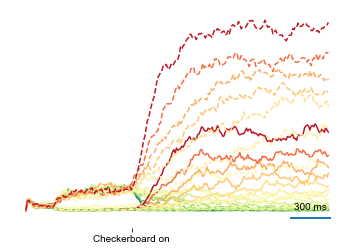

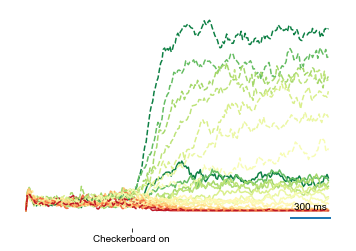

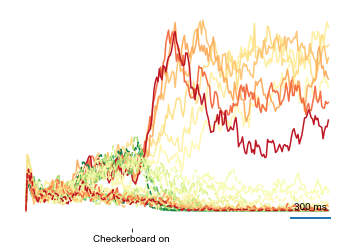

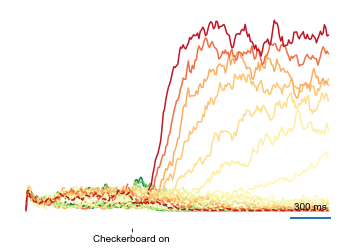

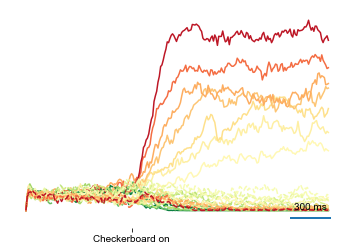

In [27]:
from pycog.trialRNN import PSTH


savepath_psths_figs = dirpath + 'sims/revision/exemplar_new/figs/psths/'
if not os.path.exists(savepath_psths_figs):
    os.makedirs(savepath_psths_figs)
    
rnnbase = dirpath + 'saved_rnns_server_apr/data/2020-04-10_cb_simple_1area/'
filename_pkl = '2020-04-10_cb_simple_1area_seed=' + '7' + '.pkl'
vin = 0.1 ** 2 
var_in = np.array(((0, 0, 0, 0), (0,0,0,0), (0,0,vin,0), (0,0,0,vin)))
var_rec = 0.05 ** 2 #0.1**2 #0.05
psth = PSTH(rnnbase + filename_pkl, modelpath, rnnparams={'var_in': var_in, 'var_rec': var_rec}, num_trials=100, seed=1, threshold=0.6)
filename = filename_pkl[:-4] # to remove the .pkl

psth.sort=['dirs', 'cohs']
psth.set_align(align='cb')
psth.gen_psth()

psth.plot_psth_pub(savepath=savepath_psths_figs, filename=filename)

## RNN's parameters

In [3]:
rnn = retrieve_object('rnn.p', loadpath_data)

In [6]:
print(dir(rnn))

['Omega_history', 'Win', 'Wout', 'Wrec', '__class__', '__delattr__', '__dict__', '__doc__', '__format__', '__getattribute__', '__hash__', '__init__', '__module__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'bout', 'brec', 'clip_weights', 'costs_history', 'defaults', 'dtype', 'fill', 'ou_defaults', 'p', 'plot_connection_matrix', 'plot_costs', 'plot_structure', 'r', 'run', 'spectral_radius', 't', 'u', 'verbose', 'x', 'x0', 'z']


In [8]:
print(rnn.p)

{'var_in': array([[0.  , 0.  , 0.  , 0.  ],
       [0.  , 0.  , 0.  , 0.  ],
       [0.  , 0.  , 0.01, 0.  ],
       [0.  , 0.  , 0.  , 0.01]]), 'var_rec': 0.0025000000000000005, 'ei': array([ 1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,
        1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1,  1